# Generate morphotope geometry with cluster information

Dissolves enclosed tessellation cells into morphotopes for visualisation purposes and links cluster information we have on buildings to each morphotope. To be displayed on the interactive map.

In [1]:
import os

import geopandas as gpd
import pandas as pd
import numpy as np
from libpysal import graph
from tqdm.auto import tqdm

In [2]:
folder = "/data/uscuni-ulce/processed_data/tessellations/"
clusters_folder = "/data/uscuni-ulce/processed_data/clusters/"
morphotope_folder = "/data/uscuni-ulce/processed_data/morphotope_clusters/"

In [3]:
v = "v10"

In [4]:
# os.mkdir(morphotope_folder)

In [5]:
regions = region_hulls = gpd.read_parquet("/data/uscuni-ulce/regions/cadastre_regions_hull.parquet")

In [6]:
model_params = '_post_processing_v1'

In [7]:
def morphotopes_to_etcs(region_id, etcs=True, model_params='_100_0_None_None_False'):


    if etcs:
        etcs = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/tessellations/tessellation_{region_id}.parquet')

    else:
        etcs = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/buildings/buildings_{region_id}.parquet')
        
    etcs['label'] = -1
    
    morphotopes = pd.read_parquet(f'/data/uscuni-ulce/processed_data/morphotopes/tessellation_labels_morphotopes_{region_id}{model_params}.pq')
    morphotopes.loc[:, 'morphotope_label'] =  morphotopes.values[:, 0]

    morph_dict = pd.Series(np.arange(np.unique(morphotopes.values).shape[0]),
                       np.unique(morphotopes.values))
    etcs.loc[morphotopes.index, 'label'] = morphotopes.map(lambda x: morph_dict.loc[x]).values
    etcs['morph'] = str(region_id) + '_' + '-1'
    etcs.loc[morphotopes.index, 'morph'] = str(region_id) + '_' + morphotopes.values
    return etcs

In [8]:
region_id = 69333

In [9]:
def generate_morphotope_geometry(region_id):

    # read data
    etcs = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/tessellations/tessellation_{region_id}.parquet')
    labels = pd.read_parquet(f'/data/uscuni-ulce/processed_data/morphotopes/tessellation_labels_morphotopes_{region_id}{model_params}.pq').morphotope_label
    etcs['label'] = labels
    etcs.label = etcs.label.fillna('-1_-1')

    # generate dissolved tesselation cells into morphotopes
    morph_geometries = etcs[~etcs["label"].str.contains("-1")].dissolve("label")
    morph_geometries.geometry = morph_geometries.buffer(.01)

    # dissolve noise etcs into contiguous geometries
    noise = etcs[etcs["label"].str.contains("-1")]
    contig = graph.Graph.build_fuzzy_contiguity(noise, buffer=0.1)
    noise_morphotopes = noise.dissolve(contig.component_labels)
    noise_morphotopes.geometry = noise_morphotopes.buffer(.01)

    complete_morphotopes = pd.concat([morph_geometries, noise_morphotopes.set_index(noise_morphotopes.index.astype(str) + '_-1')])
    complete_morphotopes.to_parquet(f'/data/uscuni-ulce/processed_data/morphtope_geometries/geoms_{region_id}{model_params}_clusters.pq')

In [10]:
%%time
generate_morphotope_geometry(region_id)

CPU times: user 38.5 s, sys: 691 ms, total: 39.2 s
Wall time: 39.1 s


In [11]:
%%time

from joblib import Parallel, delayed
n_jobs = -1
new = Parallel(n_jobs=n_jobs)(
    delayed(generate_morphotope_geometry)(region_id) for region_id, _ in regions.iterrows()
)

/home/krasen/urban_taxonomy/.pixi/envs/default/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


CPU times: user 3.67 s, sys: 1.9 s, total: 5.58 s
Wall time: 17min 35s


In [26]:
# read all morphotope geometries
geoms = []
for region_id in regions.index:
    region_morphotopes = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/morphtope_geometries/geoms_{region_id}{model_params}_clusters.pq')
    region_morphotopes = region_morphotopes[region_morphotopes.label.isna()]
    region_morphotopes.index = str(region_id) + '_' + region_morphotopes.index
    geoms.append(region_morphotopes)

morphotopes = pd.concat(geoms)

In [11]:
%%time
contig = graph.Graph.build_fuzzy_contiguity(morphotopes, buffer=0.1)

CPU times: user 4min 56s, sys: 7.39 s, total: 5min 3s
Wall time: 5min 3s


In [12]:
contig = contig.assign_self_weight()

In [14]:
# contig.to_parquet('/data/uscuni-ulce/processed_data/morphtope_geometries/graph.pq')

In [15]:
morphotopes_dir = '/data/uscuni-ulce/processed_data/morphotopes/'

def read_morphotopes_chars():
    
    data = []
    for region_id, _ in region_hulls.iterrows():
        extra_chars = pd.read_parquet(f'{morphotopes_dir}morph_chars_{region_id}.pq')
        data.append(extra_chars)
    
    data = pd.concat(data)
    return data

In [16]:
morph_chars_data = read_morphotopes_chars()

In [66]:
# contig = read_parquet('/data/uscuni-ulce/processed_data/morphtope_geometries/graph.pq')
# contig = contig.assign_self_weight()

# connected_area = morph_chars_data['limAre'].loc[contig.unique_ids]
# connected_per = morph_chars_data['limPer'].loc[contig.unique_ids]

# res_area = contig.lag(connected_area)
# res_perim = contig.lag(connected_per)


# morph_chars_data['limAre_lag'] = pd.Series(connected_area, index = contig.unique_ids)
# morph_chars_data['limPer_lag'] = pd.Series(connected_per, index = contig.unique_ids)

# del contig

In [19]:
prague_data = morph_chars_data[morph_chars_data.index.str.startswith('69333')]

In [ ]:
prague_geoms = morphotopes[morphotopes.index.str.startswith('69333')]

In [24]:
prague_graph = contig.subgraph(prague_geoms.index)

In [26]:
prague_geoms_simplified = prague_geoms.simplify(1)

In [28]:
import matplotlib.pyplot as plt

In [37]:

# m = prague_graph.explore(prague_geoms_simplified)
# prague_geoms_simplified.explore(m=m)

# Morphotope combinations

In [11]:
from libpysal.graph import read_parquet

contig = read_parquet('/data/uscuni-ulce/processed_data/morphtope_geometries/graph.pq')
contig = contig.assign_self_weight()

In [12]:
import momepy as mm
import numpy as np
import numba
import geopandas as gpd
import pandas as pd
import shapely
from sklearn.preprocessing import StandardScaler
from collections import namedtuple
from core.cluster_validation import get_linkage_matrix
from libpysal.graph import read_parquet, Graph
from core.generate_context import spatially_weighted_partial_lag
from core.generate_clusters import preprocess_clustering_data
from sklearn.cluster import AgglomerativeClustering
from core.cluster_validation import get_linkage_matrix
from scipy.cluster.hierarchy import fcluster
from core.utils import used_keys

/home/krasen/urban_taxonomy/.pixi/envs/default/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/krasen/urban_taxonomy/.pixi/envs/default/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [13]:
model_params = '_post_processing_v1'

In [14]:
regions_datadir = "/data/uscuni-ulce/"
morphotopes_dir = '/data/uscuni-ulce/processed_data/morphotopes/'

# model_params = '_75_0_None_None_False'


clip = None
to_drop = [
        'stcSAl','stbOri','stcOri','stbCeA',
        'ldkAre', 'ldkPer', 'lskCCo', 'lskERI','lskCWA', 'ltkOri', 'ltkWNB', 'likWBB', 'likWCe',
          'licBAD', 'misBAD',
    'ssbCCM','ssbCCD'    
]


linkage = 'complete'
metric = 'euclidean'

morphotope_stat_columns = ['percentile_25', 'percentile_75', 'mean', 'std']

In [15]:
def preprocess_data(data, scalar, drop_columns=morphotope_stat_columns):
    component_data = data.drop(columns=drop_columns, level=1)
    component_data = component_data.drop(columns=to_drop, level=0)
    component_data.columns =  component_data.columns.get_level_values(0)
    
    component_data = component_data[component_data.index.str[-2:] != '-1']
    
    vals = scalar.fit_transform(component_data)
    component_data = pd.DataFrame(vals, columns=component_data.columns, index=component_data.index)
    component_data = component_data.drop(component_data.columns[component_data.std() == 0], axis=1)
    
    # component_data = component_data[component_data.index >= 0]
    vals = np.nan_to_num(component_data)
    component_data = pd.DataFrame(vals, columns=component_data.columns, index=component_data.index)
    return component_data

def read_region_morphotope_data(region_id, scalar, read_extra=False):
    print('processing' , region_id)
    data = pd.read_parquet(f'{morphotopes_dir}data_morphotopes_{region_id}{model_params}.pq')
    
    data.index = str(region_id) + '_' + data.index
    data = data.iloc[:, :-1]
    component_data = preprocess_data(data, scalar)


    if read_extra:
        extra_chars = pd.read_parquet(f'{morphotopes_dir}morph_chars_{region_id}.pq')
        vals = scalar.fit_transform(extra_chars)
        extra_chars = pd.DataFrame(vals, columns=extra_chars.columns, index=extra_chars.index).fillna(0)
        extra_chars = extra_chars.drop(component_data.columns[component_data.std() == 0], axis=1)
        extra_chars = extra_chars[['limLPS']]
        extra_chars['limLPS2'] = extra_chars['limLPS']

        merged_data = pd.merge(component_data, extra_chars, how='inner', left_index=True, right_index=True)
        pd.testing.assert_index_equal(merged_data.index, component_data.index)
        component_data = merged_data
    
    return component_data

def get_morphotope_linkage(region_data):
    
    clusterer = AgglomerativeClustering(linkage=linkage,
                                        metric=metric,
                                        compute_full_tree=True,
                                        compute_distances=True)
    model = clusterer.fit(region_data)
    linkage_matrix = get_linkage_matrix(model)
    return linkage_matrix


def get_all_clusters(cutoff):
    
    all_clusters = []
    
    for region_id, _ in region_hulls.iterrows():
        data = read_region_morphotope_data(region_id, scalar=StandardScaler())
        region_index = data.index
        linkage_matrix = np.load(f'/data/uscuni-ulce/processed_data/morphotope_linkage/{linkage}_{metric}_{region_id}.npy')
        clusters = fcluster(linkage_matrix, t=cutoff, criterion='distance')
        clusters = pd.Series(clusters, region_index).astype(str)
        clusters = str(region_id) + '_' +clusters
        all_clusters.append(clusters)
    
    all_clusters = pd.concat(all_clusters)
    
    return all_clusters


def read_morphotopes_data(model_params):
    
    data = []
    for region_id, _ in region_hulls.iterrows():
        region_morphotope_data = pd.read_parquet(f'{morphotopes_dir}data_morphotopes_{region_id}{model_params}.pq')
        region_morphotope_data.index = str(region_id) + '_' + region_morphotope_data.index.str[:]
        data.append(region_morphotope_data)
    
    data = pd.concat(data)
    return data

def read_morphotopes_chars():
    
    data = []
    for region_id, _ in region_hulls.iterrows():
        extra_chars = pd.read_parquet(f'{morphotopes_dir}morph_chars_{region_id}.pq')
        data.append(extra_chars)
    
    data = pd.concat(data)
    return data 
    

def morphotopes_to_etcs(region_id, etcs=True, model_params='_100_0_None_None_False'):


    if etcs:
        etcs = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/tessellations/tessellation_{region_id}.parquet')

    else:
        etcs = gpd.read_parquet(f'/data/uscuni-ulce/processed_data/buildings/buildings_{region_id}.parquet')
        
    etcs['label'] = -1
    
    morphotopes = pd.read_parquet(f'/data/uscuni-ulce/processed_data/morphotopes/tessellation_labels_morphotopes_{region_id}{model_params}.pq')
    morphotopes.loc[:, 'morphotope_label'] =  morphotopes.values[:, 0]

    morph_dict = pd.Series(np.arange(np.unique(morphotopes.values).shape[0]),
                       np.unique(morphotopes.values))
    etcs.loc[morphotopes.index, 'label'] = morphotopes.map(lambda x: morph_dict.loc[x]).values
    etcs['morph'] = str(region_id) + '_' + '-1'
    etcs.loc[morphotopes.index, 'morph'] = str(region_id) + '_' + morphotopes.values
    return etcs

In [16]:

regions_datadir = "/data/uscuni-ulce/"
region_hulls = gpd.read_parquet(
        regions_datadir + "regions/" + "cadastre_regions_hull.parquet"
)

In [17]:
%%time
# read morphotopes data
morphotopes_data = read_morphotopes_data(model_params)
morphotopes_data = morphotopes_data[~morphotopes_data.index.str.endswith('-1')]
morphotopes_data = morphotopes_data.iloc[:, :-1]

## drop unwanted columns
component_data = morphotopes_data.drop(columns=morphotope_stat_columns, level=1)
component_data = component_data.drop(columns=to_drop, level=0)
component_data.columns = component_data.columns.get_level_values(0)



CPU times: user 22.3 s, sys: 8.43 s, total: 30.8 s
Wall time: 15.4 s


In [18]:
# add morphotope variables
morph_chars_data = read_morphotopes_chars()
morph_chars_data = morph_chars_data[['limLPS', 'limAre', 'limPer']]
merged_data = pd.merge(component_data, morph_chars_data, how='inner', left_index=True, right_index=True)
pd.testing.assert_index_equal(merged_data.index, component_data.index)
component_data = merged_data

In [19]:

grouped_data = component_data

In [20]:
## Drop massive outliers
grouped_data = grouped_data.drop(grouped_data[(grouped_data['limAre'] > 5e5) | (grouped_data['limPer'] > 2e5) | (grouped_data['ldbPWL'] > 5_000) | (grouped_data.sdbAre < 20)].index)

In [21]:
# drop columns
grouped_data = grouped_data.drop(['ssbCor', 'mtdDeg', 'limPer',  'mtbSWR'], axis=1)

In [22]:
from sklearn.preprocessing import StandardScaler
scalar = StandardScaler()
vals = scalar.fit_transform(grouped_data)
vals = np.nan_to_num(vals, 0)
regional_ward_morphotopes_data = pd.DataFrame(vals, index=grouped_data.index, columns=grouped_data.columns)

,sdbAre,sdbPer,sdbCoA,ssbCCo,ssbSqu,ssbERI,ssbElo,libNCo,ldbPWL,ltcBuA,...,mibElo,mibERI,mibCCo,mibLAL,mibFR,mibSCo,micBAD,midBAD,limLPS,limAre
4_0_1,0.987137,1.433775,-0.003262,-1.949620,-0.424706,0.483494,-2.019151,-0.08234,0.208525,0.081287,...,-1.315770,0.462303,-0.613538,0.493512,1.521773,1.521773,3.654263,4.850005,0.149898,3.887056
4_0_10,0.999498,1.196410,-0.003262,-0.789406,-0.342916,0.486163,-1.535531,-0.08234,0.182541,-0.233554,...,-0.153381,0.395069,0.056334,0.486932,1.216988,1.216988,1.178967,1.099998,0.149898,0.893068
4_0_100,-0.137159,-0.163803,-0.003262,-0.466113,-0.366240,-0.856290,0.731951,-0.08234,-0.106013,-0.458441,...,-0.521085,-0.580478,-0.558703,-0.081649,-0.032863,-0.032863,-0.203994,-0.233173,0.149898,-0.317867
4_0_101,-0.459409,-0.503755,-0.003262,0.343387,-0.298401,0.174042,0.749521,-0.08234,0.061081,-1.357987,...,-0.639787,-1.158760,-1.204788,0.178917,0.258876,0.258876,-0.310458,-0.336999,0.149898,-0.233568
4_0_102,2.676117,2.777188,-0.003262,-3.146540,-0.373569,0.244430,-2.962140,-0.08234,0.327391,0.081287,...,-2.175354,0.401162,-1.384519,0.805433,1.585684,1.585684,0.688806,0.228241,0.149898,0.615805
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
152511_809_0,0.378060,0.452225,-0.003262,0.986065,-0.155806,-0.260933,1.028036,-0.08234,-0.345792,1.340653,...,1.064571,0.742462,1.252631,-0.467798,-0.553549,-0.553549,-0.185301,-0.115341,0.149898,-0.399705
152511_8_0,0.288760,0.448556,-0.003262,-0.052106,-0.203213,0.491686,-0.223015,-0.08234,-0.356453,1.340653,...,0.193617,0.842279,0.855323,-0.447989,-0.568171,-0.568171,-0.077163,-0.033948,0.149898,-0.351100
152511_8_1,0.493941,0.612191,-0.003262,0.223337,-0.193634,-1.845646,0.758600,-0.08234,-0.345008,1.340653,...,0.903872,0.536746,0.971907,-0.478463,-0.501992,-0.501992,0.078303,-0.074908,0.149898,-0.265919
152511_8_2,0.603987,0.717053,-0.003262,0.284544,-0.195905,0.488063,-0.253222,-0.08234,-0.333686,1.340653,...,0.153683,0.840281,1.026858,-0.438514,-0.445666,-0.445666,-0.183356,-0.211640,0.149898,-0.405401


In [24]:
prague_data = regional_ward_morphotopes_data[regional_ward_morphotopes_data.index.str.startswith('69333')]

In [33]:
prague_geoms = morphotopes[morphotopes.index.isin(prague_data.index)]

In [ ]:
prague_geoms_simplified = prague_geoms.simplify(1)

In [34]:
prague_graph = Graph.build_fuzzy_contiguity

In [40]:
prague_graph = Graph.build_fuzzy_contiguity(prague_geoms_simplified, buffer=1)

In [41]:
from sklearn.cluster import AgglomerativeClustering


In [54]:
clusterer = AgglomerativeClustering(linkage='complete',
                                    metric='euclidean',
                                    connectivity=prague_graph.sparse,
                                    compute_full_tree=True,
                                    compute_distances=True)
clusterer.fit(prague_data)

/home/krasen/urban_taxonomy/.pixi/envs/default/lib/python3.12/site-packages/sklearn/cluster/_agglomerative.py:596: UserWarning: the number of connected components of the connectivity matrix is 584 > 1. Completing it to avoid stopping the tree early.
  connectivity, n_connected_components = _fix_connectivity(


AgglomerativeClustering(compute_distances=True, compute_full_tree=True,
                        connectivity=<Compressed Sparse Row sparse array of dtype 'float64'
	with 8467 stored elements and shape (2799, 2799)>,
                        linkage='complete')

In [55]:
linkage_matrix = get_linkage_matrix(clusterer)

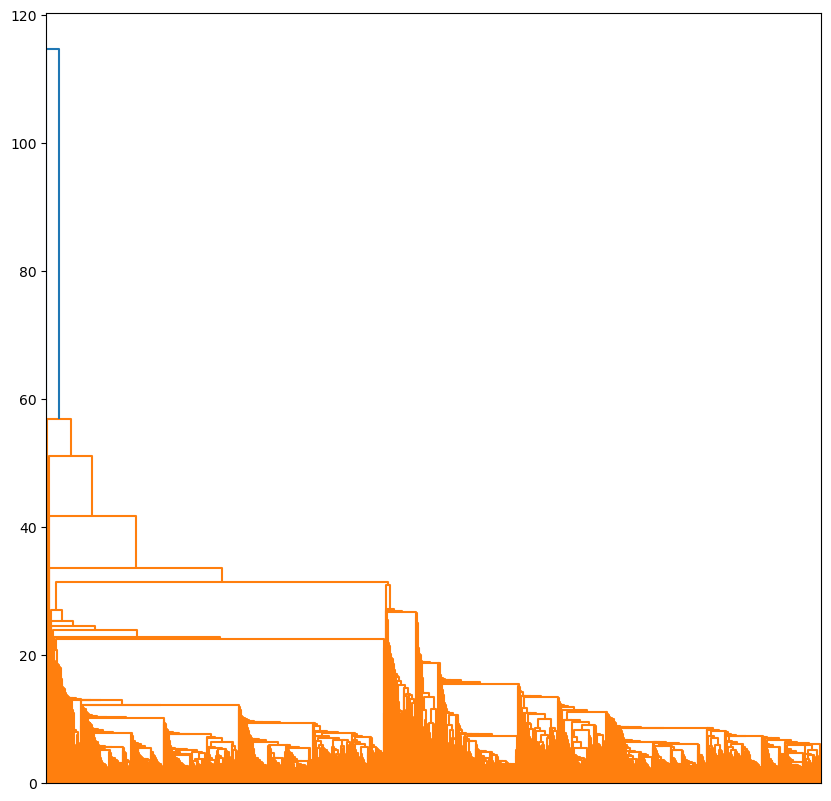

In [56]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram
fig,ax = plt.subplots(figsize=(10,10))
_ = dendrogram(linkage_matrix, ax=ax, no_labels=True)

In [58]:
final_cutoff = 10
clusters = fcluster(linkage_matrix, t=final_cutoff, criterion='distance')
final_clusters = pd.Series(clusters, prague_data.index)
final_clusters.value_counts()

186    759
59     505
46     274
47     271
161    217
      ... 
217      1
210      1
164      1
114      1
199      1
Name: count, Length: 229, dtype: int64

In [59]:
to_plot = prague_geoms_simplified.to_frame()
to_plot['label'] = final_clusters

In [60]:
to_plot.explore()

In [10]:
def generate_morphotope_geometry(region_id):
    tess = gpd.read_parquet(f"{folder}tessellation_{region_id}.parquet")
    blg = gpd.read_parquet(f"{clusters_folder}clusters_{region_id}_{v}.pq")
    tess_w_data = tess.join(blg[["morph", "final", "regional", "final_without_noise"]], how="inner")

    morphotopes = tess_w_data[~tess_w_data["morph"].str.contains("-1")].dissolve("morph")
    morphotopes.geometry = morphotopes.buffer(.01)

    noise = tess_w_data[tess_w_data["morph"].str.contains("-1")]
    contig = graph.Graph.build_fuzzy_contiguity(noise, buffer=0.1)
    noise_morphotopes = noise.dissolve(contig.component_labels)
    noise_morphotopes.geometry = noise_morphotopes.buffer(.01)
    complete_morphotopes = pd.concat([morphotopes, noise_morphotopes.set_index("morph")])

    complete_morphotopes.to_parquet(f"{morphotope_folder}{region_id}_clusters.pq")

In [11]:
for region in tqdm(regions.index[::-1]):
    generate_morphotope_geometry(region)

  0%|          | 0/847 [00:00<?, ?it/s]